## Figures

- Figure ST2 A,B,C,D
- Figure ST3 E,F

## Required files

- `models_dir / "model.results.finished.csv`
- `models_dir / 'dfi_subset.annotated.v3.parq`
- `models_dir / exp / f'deeplift/{t}/out/{experiments[exp]["imp_score"]}/modisco.h5'`
  - for all 6 models

## Produced files

`fdir = Path(f'{ddir}/figures/method-comparison/modisco')`

- Figure ST2 A
  - `fdir / 'auPRC.binary-vs-profile+binary.bar.pdf'`
- Figure ST2 B
  - `fdir / 'training-time.bar.pdf'`
- Figure ST2 C
  - `fdir / 'nexus.profile-vs-binary.motif-venn.heatmap.pdf'`
- Figure ST2 D
  - `fdir / 'profile-recall.nexus.profile-vs-binary.pdf'`
- Figure ST3 E
  - `fdir / 'nexus-vs-seq.motif-venn.heatmap.pdf'`
- Figure ST3 F
  - `fdir / 'profile-recall.nexus-vs-seq.pdf'`

In [1]:
from collections import OrderedDict
exp = 'nexus,peaks,OSNK,0,10,1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE'
imp_score = 'profile/wn'

motifs = OrderedDict([
    ("Oct4-Sox2", 'Oct4/m0_p0'),
    ("Oct4", 'Oct4/m0_p1'),
    # ("Strange-sym-motif", 'Oct4/m0_p5'),
    ("Sox2", 'Sox2/m0_p1'),
    ("Nanog", 'Nanog/m0_p1'),
    ("Zic3", 'Nanog/m0_p2'),
    ("Nanog-partner", 'Nanog/m0_p4'),
    ("Klf4", 'Klf4/m0_p0'),
])

In [2]:
models = {
    'nexus/binary': 'nexus,gw,OSNK,1,0,0,FALSE,same,0.5,64,25,0.001,9,FALSE',
    'nexus/profile': 'nexus,peaks,OSNK,0,10,1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE',
    'seq/profile': 'seq,peaks,OSN,0,10,1,FALSE,same,0.5,64,50,0.004,9,FALSE,[1,50],TRUE,TRUE',
    'seq/binary': 'seq,gw,OSN,1,0,0,FALSE,same,0.5,64,50,0.001,9,FALSE',
    'nexus/profile.peaks-union': 'nexus,nexus-seq-union,OSN,0,10,1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE,TRUE,0',
    'seq/profile.peaks-union': 'seq,nexus-seq-union,OSN,0,10,1,FALSE,same,0.5,64,50,0.004,9,FALSE,[1,50],TRUE,TRUE,0',
}
models_inv = {v:k for k,v in models.items()}

In [3]:
from basepair.imports import *
from basepair.exp.paper.config import *
from basepair.utils import flatten
from basepair.modisco.core import Pattern
from basepair.config import test_chr
from plotnine import *
import plotnine
from config import experiments
from basepair.utils import pd_first_cols, flatten
from basepair.exp.chipnexus.comparison import read_chexmix_dfi, read_meme_motifs, read_transfac
from basepair.plot.utils import plt9_tilt_xlab
from basepair.exp.paper.config import models_dir
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
paper_config()

import sys
sys.path.insert(0, '..')

Using TensorFlow backend.


In [4]:
fdir = Path(f'{ddir}/figures/method-comparison/modisco')
fdir.mkdir(exist_ok=True)

## Show which methods were evaluated on the same intervals

In [6]:
ranges_dict = {model: ImpScoreFile(models_dir / exp  /'deeplift.imp_score.h5', default_imp_score=experiments[exp]["imp_score"]).get_ranges()
               for model, exp in models.items()}

In [7]:
{k: len(v) for k,v in ranges_dict.items()}

{'nexus/binary': 147974,
 'nexus/profile': 147974,
 'seq/profile': 68042,
 'seq/binary': 68042,
 'nexus/profile.peaks-union': 55288,
 'seq/profile.peaks-union': 55288}

### Adding profile regression to binary classification model

In [4]:
exp = models['nexus/profile']

In [5]:
model_dir = models_dir / exp

In [6]:
df_train = pd.read_csv(models_dir / "model.results.finished.csv")
df_train = df_train[df_train.exp.isin(models.values())]
df_train['exp_name'] = df_train.exp.map(models_inv)
gw_exp = ['nexus/binary', 'nexus/binary+profile']
dfp = df_train[df_train.exp_name.isin(gw_exp)][[f'valid-genome-wide/{task}/class/auPR' for task in tasks] + ['exp_name']].melt(id_vars='exp_name')
dfp['TF'] = dfp.variable.str.split("/", expand=True)[1]

dfp['TF'] = pd.Categorical(dfp['TF'], tasks)

In [16]:
colors = {"nexus/binary": "#EE8030",
          "nexus/profile": "#498AAD",
          "nexus/profile.gw": "#586BA4",
          "nexus/binary+profile": "#4E598C"
         }

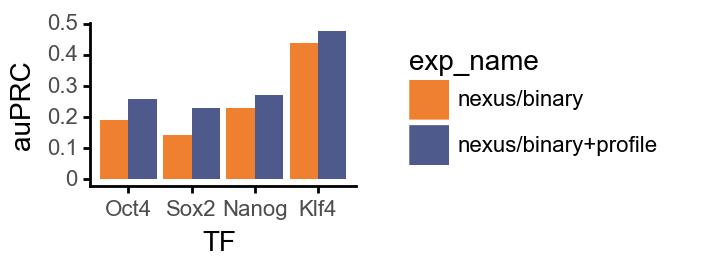

<ggplot: (8770059255602)>

In [17]:
plotnine.options.figure_size = get_figsize(.25)
fig = (ggplot(aes(x='TF', fill='exp_name', y='value'), dfp) + 
       geom_bar(stat='identity', position='dodge') + 
       theme_classic(base_size=10, base_family='Arial') +  \
       scale_fill_manual([colors[x] for x in gw_exp]) + \
       ylab("auPRC") 
      )
fig.save(fdir / 'auPRC.binary-vs-profile+binary.bar.pdf')
fig

### Training time. Binary vs profile

In [18]:
dft = pd.DataFrame([{"training_time": pd.read_csv(f"{models_dir}/{exp}/train.smk-benchmark.tsv", sep='\t').iloc[0]['s'] / 60,
              "Model": model_name,
              "exp": exp}
             for model_name, exp in models.items()])

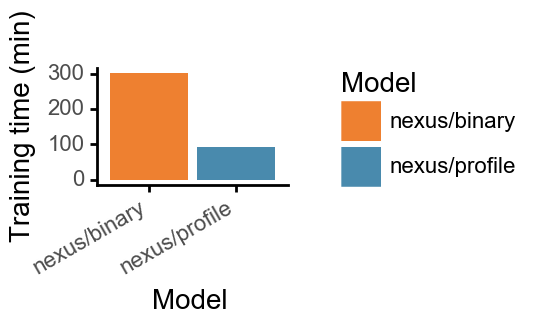

<ggplot: (8770059135012)>

In [19]:
plt_exp = ['nexus/binary', 'nexus/profile']
plotnine.options.figure_size = get_figsize(.18)
fig = (ggplot(aes(x='Model', fill='Model', y='training_time'), dft[dft.Model.isin(plt_exp)]) + 
 geom_bar(stat='identity') + 
 scale_fill_manual([colors[x] for x in plt_exp]) + \
 theme_classic(base_size=10, base_family='Arial') +  \
 xlab("Model") + 
 ylab("Training time (min)") +
 plt9_tilt_xlab(30)
)
fig.save(fdir / 'training-time.bar.pdf')
fig

## Get motif instances for BPNet-PWM scan

Just use the motifs from the Fimo scan from ChIP-nexus data 

In [8]:
from basepair.utils import read_pkl
dfi_list_chipseq = read_pkl("/oak/stanford/groups/akundaje/avsec/basepair/data/processed/comparison/chexmix-peakxus/dfi_list.chipseq.pkl")
# dfi_list_ChIP_seq[f'MEME/FIMO-{ranges_name}'] = {"name": 'MEME/FIMO',
#                                                  "dfi": dfi_meme_annotated,
#                                                  "score": "score",
#                                                  "ranges_name": ranges_name,
#                                                  "motif_method": "MEME"}

In [9]:
list(dfi_list_chipseq)

['MEME/FIMO-chip-seq', 'MEME/FIMO-chip-seq,nexus']

## TODO - figure out how to include these analyses into the recall plots

## Compare the high-quality peak recall

In [4]:
main_motifs = ['Oct4-Sox2', 'Sox2', 'Nanog', 'Klf4']  # NOTE this is a duplication from before

In [13]:
dfi = pd.read_parquet(models_dir / 'dfi_subset.annotated.v3.parq', engine='fastparquet')
dfi = dfi[dfi.example_chrom.isin(test_chr)]  # look at only the test chromosomes
dfi = dfi[dfi.pattern_name.isin(main_motifs)]

In [14]:
# Remove duplicates
dfi = dfi.sort_values("imp_weighted", ascending=False)
duplicated = dfi[['model', 'pattern_name', 'example_chrom', 'pattern_start_abs', 'pattern_end_abs', 'strand']].duplicated()
dfi = dfi[~duplicated]

# setup coordinates
dfi['Chromosome'] = dfi['example_chrom']
dfi['Start'] = dfi['pattern_start_abs']
dfi['End'] = dfi['pattern_end_abs']
dfi['Strand'] = dfi['pattern_end_abs']

In [16]:
import pyranges as pr

In [18]:
def get_profile_score(dfi, score, profile_cls):
    df = dfi[(~dfi[score].isnull())]
    return df.sort_values(score, ascending=False)[profile_cls]

motif_profile_counts = [(motif, 
                         {model: get_profile_score(dfi[(dfi.pattern_name == motif) &
                                                       (dfi.model == model) & 
                                                       (dfi.example_chrom.isin(test_chr))],
                                                   'imp_weighted', 
                                                   profile_mapping[motif]+ "/profile_counts_max_ref").values
                         for model in models})
                        for motif in main_motifs]

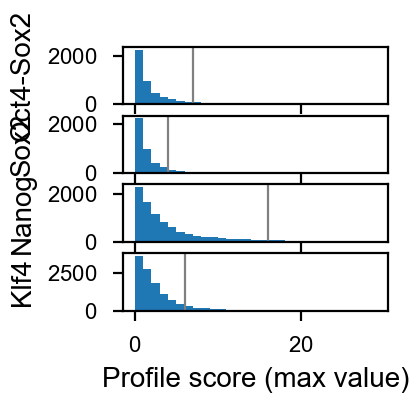

In [19]:
# Profile scores
model = 'nexus/profile'
thresholds = dict()
fig, axes = plt.subplots(len(main_motifs),1,figsize=get_figsize(0.25, 1), sharex=True)
for i, motif in enumerate(main_motifs):
    ax = axes[i]
    scores = motif_profile_counts[i][1][model]
    thresholds[motif] = np.percentile(scores, 90)
    #if len(scores) == 0:
    #    continue
    ax.hist(scores, bins=np.arange(30))
    ax.axvline(thresholds[motif], color='grey')
    ax.set_ylabel(motif)
    if i == len(main_motifs)-1:
        ax.set_xlabel("Profile score (max value)");
    # fig.savefig(fdir / 'profile-score.hist.pdf')

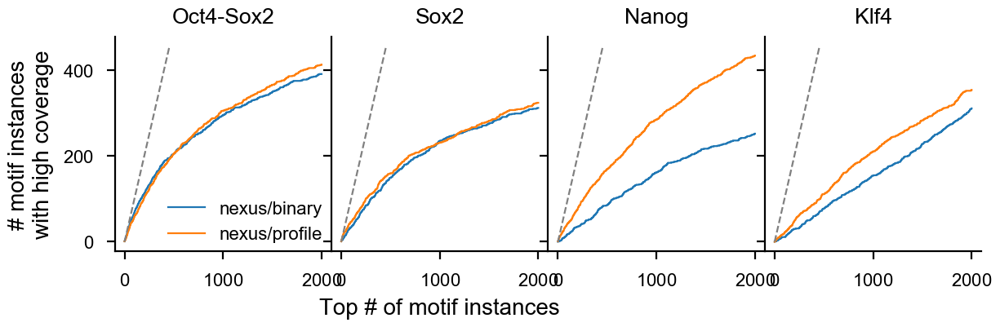

In [29]:
fig, axes = plt.subplots(1, len(main_motifs), figsize=get_figsize(1, 1/(1*len(main_motifs))), 
                         sharex=True, 
                         sharey=True, gridspec_kw=dict(wspace=0, hspace=0))
fig.subplots_adjust(wspace=.5)#, wspace=0)
max_val = 0
for i, (motif, res) in enumerate(motif_profile_counts):
    ax = axes[i]
    # top_n = min([len(x) for x in res.values()])
    top_n = 2000
    for k,v in res.items():
        if k in ['nexus/profile', 'nexus/binary']:
            cutoff = thresholds[motif]
            ax.plot(np.cumsum(v[:top_n] > cutoff), label=k)

    max_val = max(max_val, ax.get_ylim()[1])
    if i == 0:
        ax.set_ylabel("# motif instances\nwith high coverage")
    if i == 1:
        ax.set_xlabel("Top # of motif instances")
    if i == 0:
        leg = ax.legend(loc='lower right', framealpha=1, borderpad=0)
        leg.get_frame().set_linewidth(0.0)
    ax.set_title(motif)

for i, (motif, res) in enumerate(motif_profile_counts):
    axes[i].plot([0, max_val], [0, max_val], '--', color='grey', label=None)
sns.despine(top=True, right=True)    
fig.savefig(fdir / 'profile-recall.nexus.profile-vs-binary.pdf')

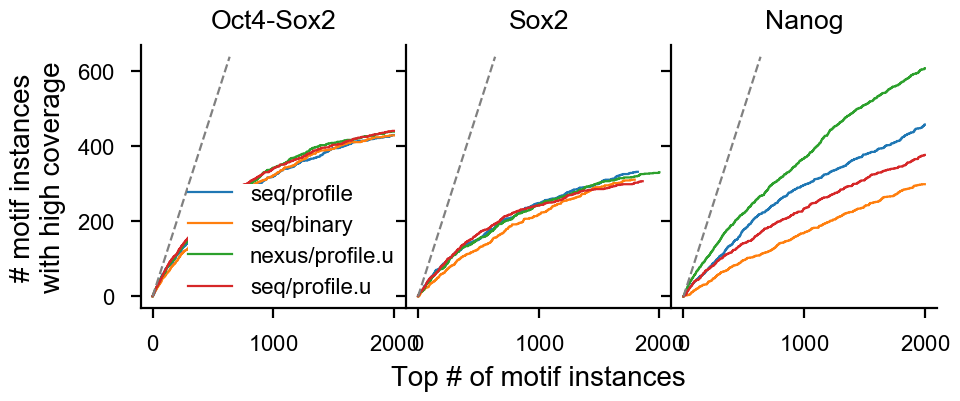

In [31]:
fig, axes = plt.subplots(1, len(main_motifs)-1, figsize=get_figsize(0.75, 1/(1*len(main_motifs)-1)), 
                         sharex=True, 
                         sharey=True, gridspec_kw=dict(wspace=0, hspace=0))
# fig, axes = plt.subplots(1, len(main_motifs)-1, figsize=get_figsize(.75, 1/(1*len(main_motifs)-1)), 
#                          sharex=True, 
#                          sharey=True, gridspec_kw=dict(wspace=0, hspace=0))

fig.subplots_adjust(wspace=.5)#, wspace=0)
max_val = 0
for i, (motif, res) in enumerate(motif_profile_counts[:-1]):
    ax = axes[i]
    # top_n = min([len(x) for x in res.values()])
    top_n = 2000
    for k,v in res.items():
        if k in ['nexus/profile.peaks-union', 'seq/profile', 'seq/profile.peaks-union', 'seq/binary']:
            cutoff = thresholds[motif]
            ax.plot(np.cumsum(v[:top_n] > cutoff), label=k.replace("peaks-union", 'u'))

    max_val = max(max_val, ax.get_ylim()[1])
    if i == 0:
        ax.set_ylabel("# motif instances\nwith high coverage")
    if i == 1:
        ax.set_xlabel("Top # of motif instances")
    if i == 0:
        leg = ax.legend(loc='bottom right', framealpha=1, borderpad=0)
        leg.get_frame().set_linewidth(0.0)
    ax.set_title(motif)

for i, (motif, res) in enumerate(motif_profile_counts[:-1]):
    axes[i].plot([0, max_val], [0, max_val], '--', color='grey', label=None)
sns.despine(top=True, right=True)   
fig.savefig(fdir / 'profile-recall.nexus-vs-seq.pdf')

## All motifs

In [156]:
from config import experiments
from basepair.exp.paper.config import get_tasks

fdir = Path(f'{ddir}/figures/method-comparison/modisco')
fdir.mkdir(exist_ok=True)

comparison_dir = Path('../../chipnexus/comparison/output')

def rename(name):
    task, mc, pattern = name.split("/")
    mc_n = mc.split("_")[1]
    pattern_n = pattern.split("_")[1]
    return f'BPNet/{task}/m{mc_n}_p{pattern_n}'

def load_patterns(exp, model):
    mr = MultipleModiscoResult({t: models_dir / exp / f'deeplift/{t}/out/{experiments[exp]["imp_score"]}/modisco.h5'
                                for t in get_tasks(exp)})
    return [p.rename(model + '/' + p.name).add_attr("n_seqlets", mr.n_seqlets(p.name))
            for p in mr.get_all_patterns()
            if mr.n_seqlets(p.name) > 100]

In [18]:
all_patterns = []
for model, exp in models.items():
    try:
        all_patterns += load_patterns(exp, model)
    except:
        print("Unable to load ", model, exp)

In [19]:
from basepair.exp.paper.fig4 import cluster_align_patterns

In [20]:
len(all_patterns)

264

In [21]:
# Cluster patterns
from basepair.exp.paper.fig4 import *
patterns = all_patterns
n_clusters = 20
sim_seq = similarity_matrix(patterns, track='seq_ic')

# cluster
iu = np.triu_indices(len(sim_seq), 1)
lm_seq = linkage(1 - sim_seq[iu], 'ward', optimal_ordering=True)

# determine clusters and the cluster order
cluster = cut_tree(lm_seq, n_clusters=n_clusters)[:, 0]
cluster_order = np.argsort(leaves_list(lm_seq))

# align patterns
aligned_patterns = align_clustered_patterns(patterns, cluster_order, cluster,
                                              align_track='seq_ic',
                                              metric='continousjaccard',
                                              # don't shit the major patterns
                                              # by more than 15 when aligning
                                              trials=20,
                                              max_shift=15)

100%|██████████| 264/264 [04:29<00:00,  1.01s/it]


Number of seqlets not provided, using random number of seqlets


100%|██████████| 264/264 [00:01<00:00, 245.96it/s]


In [22]:
write_pkl(aligned_patterns, 
          "/users/avsec/gdrive/projects/chipnexus/data/motif_clustering.patterns.pkl")

In [23]:
from basepair.modisco.motif_clustering import to_colors

In [24]:
def shorten_name(pn):
    m1, m2, tf, mc, p = pn.split("/")
    mcn = mc.split("_")[1]
    pn = p.split("_")[1]
    return f"{m1}/{m2}/{tf}/m{mcn}_p{pn}"

In [25]:
pnames = [shorten_name(p.name) for p in all_patterns]

In [26]:
df_anno = pd.DataFrame(dict(method=["/".join(pn.split("/")[:2]) for pn in pnames],
                            tf=[pn.split("/")[2] for pn in pnames]),
                       index=pnames)

In [27]:
# Alternative code
import matplotlib.colors
df = df_anno
cat_cmap='RdBu_r'
import matplotlib.pyplot as plt
import seaborn as sns
cols = {}
for c in df.columns:
    categories = list(df[c].unique())
    if c == 'tf':
        # cmap_dict = {tf: matplotlib.colors.to_rgb(hex_color)
        #             for tf, hex_color in tf_colors.items()}
        cmap_dict = tf_colors
    else:
        cmap = sns.color_palette(cat_cmap, len(categories))
        cmap_dict = dict(zip(categories, cmap))
    cols[c] = df[c].map(cmap_dict)
row_colors = pd.DataFrame(cols)

In [28]:
c = 'method'
categories = list(df[c].unique())
sns.color_palette(cat_cmap, len(categories))
cmap_dict_method = dict(zip(list(df[c].unique()), cmap))

In [29]:
from basepair.plot.utils import plot_colormap

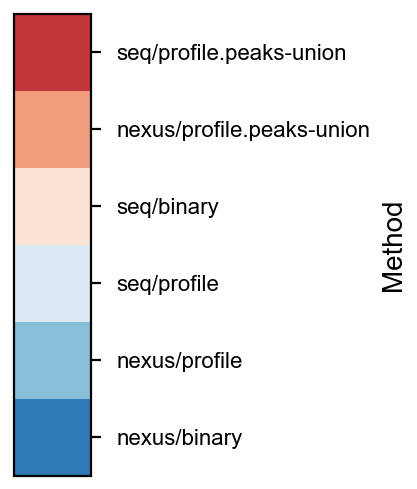

In [30]:
plot_colormap(cmap_dict_method, "Method")
# plt.savefig(fdir / 'cmap.method.pdf')

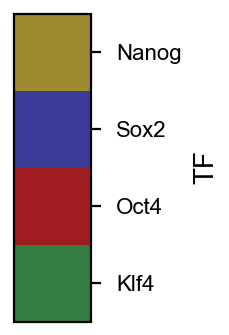

In [31]:
plot_colormap({k:v for k,v in tf_colors.items() if k !='Esrrb'}, 'TF')
# plt.savefig(fdir / 'cmap.TF.pdf')

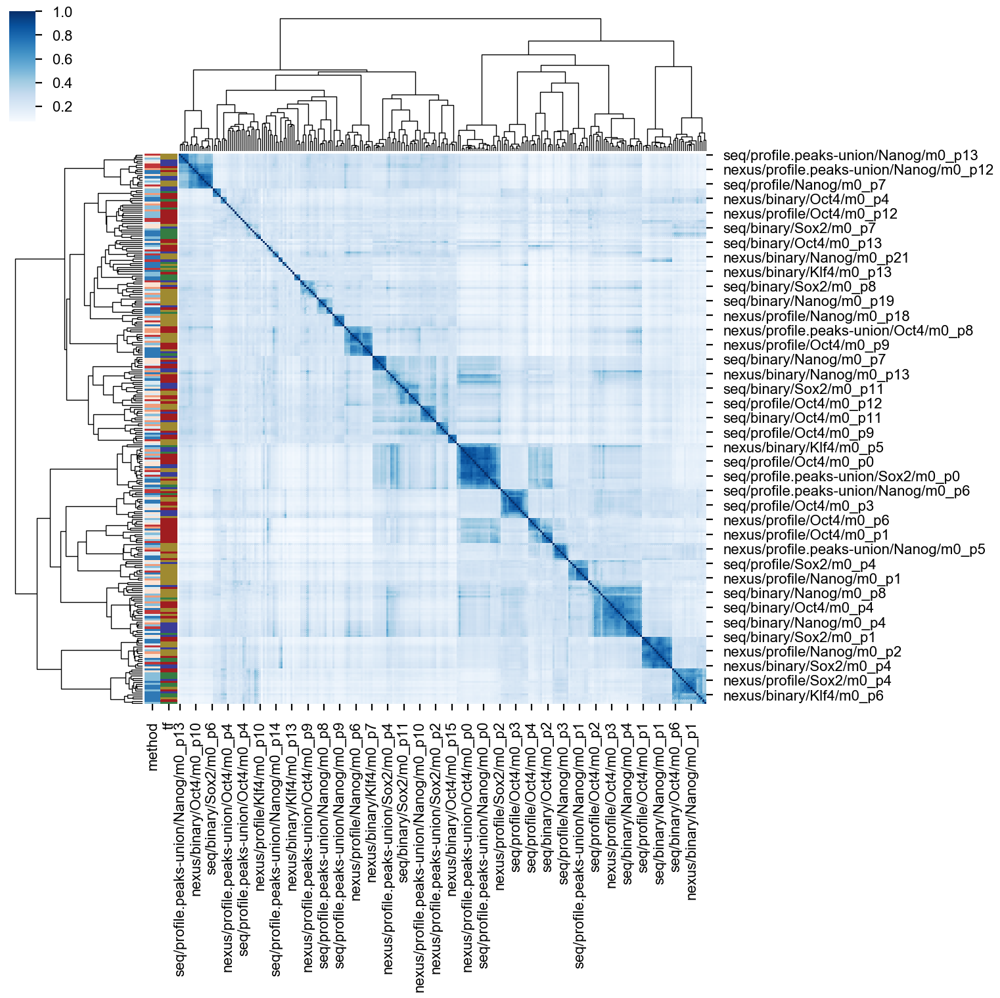

In [32]:
df = pd.DataFrame(sim_seq, 
                  index=pnames,
                  columns=pnames)
cm = sns.clustermap(df, 
                    row_linkage=lm_seq,
                    col_linkage=lm_seq,
                    row_colors=row_colors,
                    cmap='Blues', figsize=get_figsize(1, 1))
plt.savefig(fdir / 'clustered-motifs.heatmap.pdf')

In [33]:
# aligned_patterns

In [34]:
cluster20 = cut_tree(lm_seq, n_clusters=20)[:, 0]
cluster30 = cut_tree(lm_seq, n_clusters=30)[:, 0]
cluster40 = cut_tree(lm_seq, n_clusters=40)[:, 0]
cluster50 = cut_tree(lm_seq, n_clusters=50)[:, 0]
cluster60 = cut_tree(lm_seq, n_clusters=60)[:, 0]
cluster_order = np.argsort(leaves_list(lm_seq))

In [35]:
dfp = pd.DataFrame({"name": pnames,
              "cluster20": cut_tree(lm_seq, n_clusters=20)[:, 0],
              "cluster30": cut_tree(lm_seq, n_clusters=30)[:, 0],
              "cluster40": cut_tree(lm_seq, n_clusters=40)[:, 0],
              "cluster50": cut_tree(lm_seq, n_clusters=50)[:, 0],
              "cluster60": cut_tree(lm_seq, n_clusters=60)[:, 0],
             }).set_index('name').loc[np.array([shorten_name(p.name) for p in aligned_patterns])].reset_index()
dfp.to_csv("/users/avsec/gdrive/projects/chipnexus/data/motif_clustering.csv", index=None)

## Load the clustered table

In [197]:
# Create the summary table
df_n_seqlets = pd.DataFrame({
    "name": [shorten_name(p.name) for p in all_patterns],
    "n_seqlets": [p.attrs['n_seqlets'] for p in all_patterns],
})

# dfp = pd.read_csv("https://docs.google.com/spreadsheets/d/1enDvKamBZOs4-EIKy--zUebekHvhJekAmNy1yExf1VQ/export?gid=481460659&format=csv")
# dfp = pd.read_csv("https://docs.google.com/spreadsheets/d/1umWAMk-FKN2u4k8noKoaX3FZXmU3_-IurnO922cKUko/export?gid=1666626001&format=csv")
dfp = pd.read_csv("https://docs.google.com/spreadsheets/d/1G_vC2Y9j45WuN08Erzm8M57uNWsXl4Obl9WR2zKA6dc/export?gid=47535911&format=csv")
dfp['label'] = dfp.label.str.replace('"', '')
dfp = pd.merge(dfp, df_n_seqlets, on='name')
dfp['method'] = dfp.name.str.rsplit("/", n=2, expand=True)[0]
dfpm = pd.pivot_table(dfp, values='n_seqlets', index='label', columns='method', aggfunc=np.sum, fill_value=0)

In [199]:
noisy_motifs = list(dfpm.index.unique()[dfpm.index.unique().str.startswith("noisy")])

In [200]:
erronious = dfp.query('erronious').label.unique()

In [201]:
dfpm = dfpm.loc[dfpm.sum(1).sort_values(ascending=False).index]
dfpm = pd.concat([
    dfpm[~dfpm.index.isin(erronious)],
    dfpm.loc[erronious]
])

In [202]:
def remove_zeroes(df):
    df = df[df.max(axis=1)!=0]
    dfpm = df.loc[df.sum(1).sort_values(ascending=False).index]
    dfpm = pd.concat([
        dfpm[~dfpm.index.isin(erronious)],
        dfpm[dfpm.index.isin(erronious)]
    ])
    return dfpm

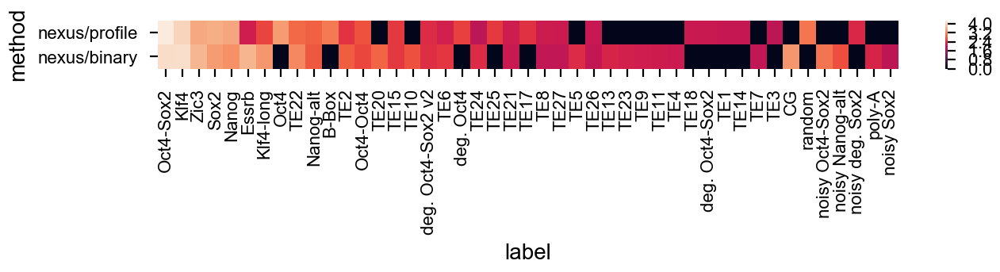

In [223]:
fig, ax = plt.subplots(figsize=get_figsize(1.1, 1/19))
sns.heatmap(np.log10(remove_zeroes(dfpm[['nexus/profile','nexus/binary',
                           # 'seq/profile',# 'seq/binary',
                           # 'nexus/profile.peaks-union', 'seq/profile.peaks-union'
                           ]]) + 1).T,
           xticklabels=True);
fig.savefig(fdir / 'nexus.profile-vs-binary.motif-venn.heatmap.pdf')

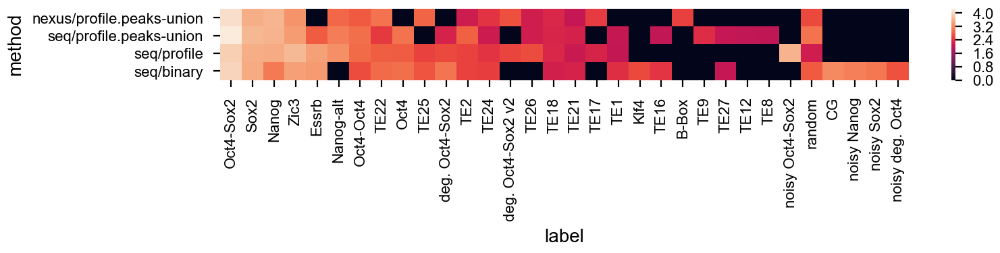

In [224]:
fig, ax = plt.subplots(figsize=get_figsize(1.2, 1/12))
sns.heatmap(np.log10(remove_zeroes(dfpm[[
                           'nexus/profile.peaks-union', 
                           'seq/profile.peaks-union',
                           'seq/profile',
                           'seq/binary',
                           
                           ]]) + 1).T);
fig.savefig(fdir / 'nexus-vs-seq.motif-venn.heatmap.pdf')

In [218]:
fdir

PosixPath('/users/avsec/workspace/basepair/data/figures/method-comparison/modisco')

In [76]:
len(dfp)

266

In [78]:
len(aligned_patterns)

266

In [83]:
dict(row)

{'name': 'nexus/profile.peaks-union/Nanog/m0_p13',
 'cluster20': 8,
 'cluster30': 29,
 'cluster40': 33,
 'cluster50': 41,
 'cluster60': 44,
 'label': 'TE1',
 'n_seqlets': 115,
 'method': 'nexus/profile.peaks-union'}

## Plot all the aligned patterns

In [37]:
len(aligned_patterns)

264

In [206]:
dfp

,name,cluster20,cluster30,cluster40,cluster50,cluster60,label,erronious,n_seqlets,method
0,seq/profile.peaks-uni...,8,29,37,42,46,TE1,False,115,seq/profile.peaks-union
1,seq/binary/Nanog/m0_p16,8,29,37,42,46,TE1,False,128,seq/binary
2,nexus/profile/Nanog/m...,8,29,37,42,46,TE1,False,127,nexus/profile
...,...,...,...,...,...,...,...,...,...,...
261,nexus/binary/Nanog/m0_p6,2,2,7,7,7,Klf4-long,False,747,nexus/binary
262,nexus/binary/Oct4/m0_p8,2,2,7,7,7,Klf4-long,False,497,nexus/binary
263,nexus/profile/Klf4/m0_p5,2,2,7,7,7,Klf4-long,False,434,nexus/profile


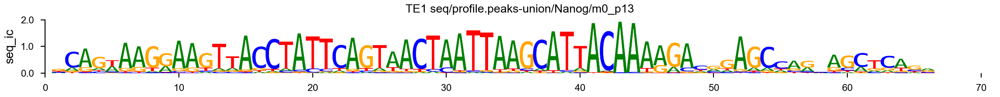

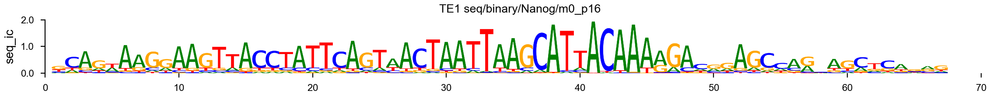

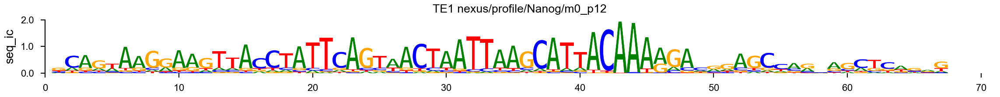

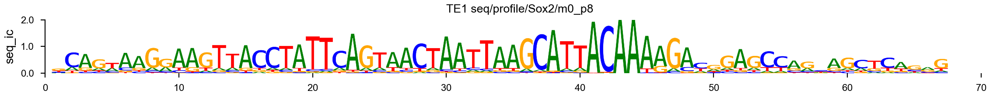

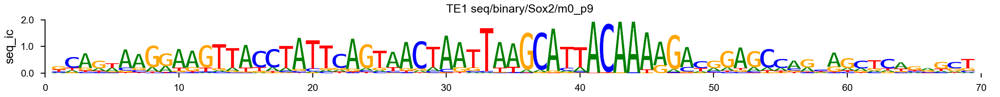

...

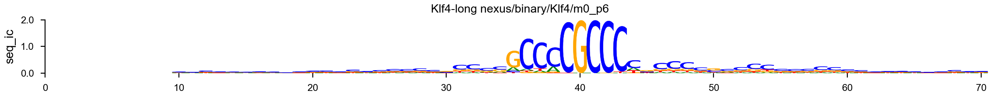

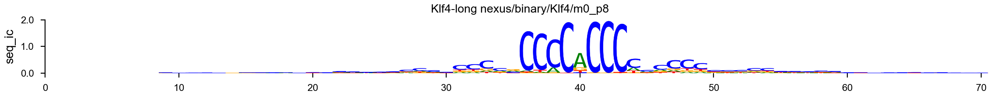

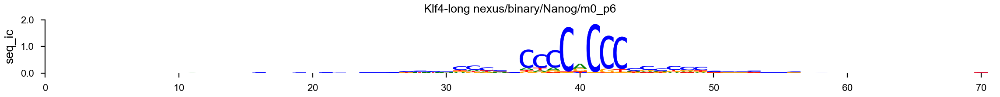

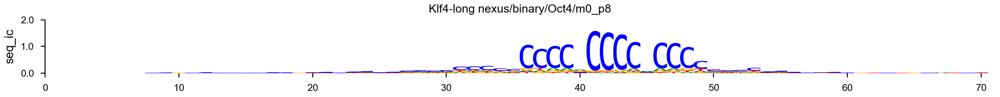

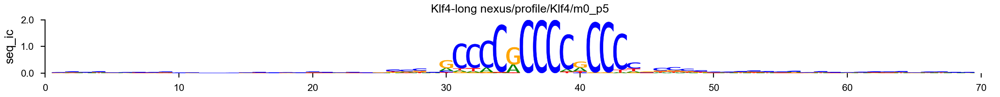

In [217]:
for i, p in enumerate(aligned_patterns):
    p.plot("seq_ic");
    row = dfp[dfp.name == shorten_name(p.name)].iloc[0]
    err = 'erronious ' if row.erronious else ''
    plt.title(err + f"{row.label} {row['name']}")
    # plt.title(p.name)
    plt.ylim([0, 2])
    sns.despine(bottom=True, right=True, top=True)